In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import os
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import osmnx as ox 
from shapely.geometry import Point, LineString

In [2]:
# 1. read bus stops geojson
bus_stops = gpd.read_file('data/raw/tfl/Bus_Stops.geojson')
bus_stops = bus_stops.to_crs(epsg=27700)
bus_stops['STOP_CODE'] = bus_stops['STOP_CODE'].astype(str).str.strip() # CONVERT STOP_CODE TO STR

# 2. load bus stop data
bus_stops1 = pd.read_csv('data/raw/tfl/bus-stops.csv')
bus_stops1['Bus_Stop_Code'] = bus_stops1['Bus_Stop_Code'].astype(str).str.strip() # CONVERT STOP_CODE TO STR

# combine bus_stops and bus_stops1 with stop_code
bus_stops = bus_stops.merge(bus_stops1, left_on='STOP_CODE', right_on='Stop_Code_LBSL', how='outer')

# fill stop_code with Stop_Code_LBSL
bus_stops['STOP_CODE'] = bus_stops['STOP_CODE'].fillna(bus_stops['Stop_Code_LBSL'])
bus_stops['STOP_NAME'] = bus_stops['STOP_NAME'].fillna(bus_stops['Stop_Name'])
bus_stops['OS_EASTING'] = bus_stops['OS_EASTING'].fillna(bus_stops['Location_Easting'])
bus_stops['OS_NORTHING'] = bus_stops['OS_NORTHING'].fillna(bus_stops['Location_Northing'])
bus_stops['geometry'] = [Point(x, y) for x, y in zip(bus_stops['OS_EASTING'], bus_stops['OS_NORTHING'])]

# filter to necessary columns
bus_stops = bus_stops[['STOP_CODE', 'STOP_NAME', 'OS_EASTING', 'OS_NORTHING','geometry']]
bus_stops = gpd.GeoDataFrame(bus_stops, geometry='geometry', crs='epsg:27700')
bus_stops.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 21540 entries, 0 to 21539
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   STOP_CODE    21540 non-null  object  
 1   STOP_NAME    21517 non-null  object  
 2   OS_EASTING   21540 non-null  float64 
 3   OS_NORTHING  21540 non-null  float64 
 4   geometry     21540 non-null  geometry
dtypes: float64(2), geometry(1), object(2)
memory usage: 841.5+ KB


In [3]:
# import bus data
file1 = pd.read_csv(os.path.join('data/raw/tfl/FOI-0097-2425_1.CSV'))
file2 = pd.read_csv(os.path.join('data/raw/tfl/FOI-0097-2425_2.CSV'))

# concatenate the two files
bus_entex = pd.concat([file1, file2])

# replace 'less than 5' with 0
bus_entex = bus_entex.replace('less than 5', 0)

# convert to numeric
bus_entex['n_boarders'] = pd.to_numeric(bus_entex['n_boarders'])
bus_entex['n_alighters'] = pd.to_numeric(bus_entex['n_alighters'])

bus_entex.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1795533 entries, 0 to 795532
Data columns (total 6 columns):
 #   Column       Dtype 
---  ------       ----- 
 0   traveldate   int64 
 1   stop_id      object
 2   stop_name    object
 3   route_id     object
 4   n_boarders   int64 
 5   n_alighters  int64 
dtypes: int64(3), object(3)
memory usage: 95.9+ MB


In [4]:
bus_entex.head()

,traveldate,stop_id,stop_name,route_id,n_boarders,n_alighters
0,20231001,1000,Westminster Stn / Parliament Square,12,132,127
1,20231001,1000,Westminster Stn / Parliament Square,159,198,38
2,20231001,1000,Westminster Stn / Parliament Square,453,184,129
3,20231001,1000,Westminster Stn / Parliament Square,N109,5,0
4,20231001,1000,Westminster Stn / Parliament Square,N12,5,0


FUNCTION TO FILTER BUS DATA BY DATE

In [5]:
# function filter bus data by date, average 
def bus_entex_by_day(date):
    
    wk_dict = {'mon': [20231002, 20231009, 20231016, 20231023, 20231030],
               'tue': [20231003, 20231010, 20231017, 20231024, 20231031],
               'wed': [20231004, 20231011, 20231018, 20231025],
               'thu': [20231005, 20231012, 20231019, 20231026], 
               'fri': [20231006, 20231013, 20231020, 20231027],
               'sat': [20231007, 20231014, 20231021, 20231028],
               'sun': [20231001, 20231008, 20231015, 20231022, 20231029]
    }

    df = bus_entex[bus_entex['traveldate'].isin(wk_dict[date])]
    # group by stop_id, stop_name, route_id
    df = df.groupby(['stop_id', 'stop_name', 'route_id']).mean().reset_index().drop(columns=['traveldate'])
    
    # Merge with bus stops
    df_merge = df.merge(bus_stops, left_on='stop_id', right_on='STOP_CODE')
    df_merge = gpd.GeoDataFrame(df_merge, geometry='geometry') # geo data frame
    df_merge = df_merge.drop(columns=['STOP_CODE', 'STOP_NAME'])
        
    return df_merge

bus_entex_by_day('sat').head()


,stop_id,stop_name,route_id,n_boarders,n_alighters,OS_EASTING,OS_NORTHING,geometry
0,1000,Westminster Stn / Parliament Square,12,75.25,38.75,530171.0,179738.0,POINT (530171.000 179738.000)
1,1000,Westminster Stn / Parliament Square,159,107.50,58.25,530171.0,179738.0,POINT (530171.000 179738.000)
2,1000,Westminster Stn / Parliament Square,35,0.00,0.00,530171.0,179738.0,POINT (530171.000 179738.000)
3,1000,Westminster Stn / Parliament Square,453,153.75,88.75,530171.0,179738.0,POINT (530171.000 179738.000)
4,1000,Westminster Stn / Parliament Square,N109,12.25,0.00,530171.0,179738.0,POINT (530171.000 179738.000)


FUNCTION TO PLOT SINGLE ROUTE

In [6]:
# define function to plot according to route_id
def plot_route(day,route_id):
    
    route_id = str(route_id)    #convert route_id to string#
    day = str(day).lower() # convert day to lower case
    bus_entex_day = bus_entex_by_day(day) # filter data by day

    df_plot = bus_entex_day[bus_entex_day.route_id==route_id] # filter data for the route_id
    
    # import london boroughs
    boroughs = gpd.read_file(os.path.join('data','shapefile','statistical-gis-boundaries-london','ESRI','London_Borough_Excluding_MHW.shp'))
    boroughs = boroughs.to_crs(epsg=27700) # change crs to 4326                   

    # plot
    # get minmax values for colorbar, min of both n_boarders and n_alighters
    vmin = df_plot[['n_boarders','n_alighters']].min().min()
    vmax = df_plot[['n_boarders','n_alighters']].max().max()

    # cmap
    cmap = plt.cm.viridis
    fig,ax = plt.subplots(2,1,figsize=(15,20))

    df_plot.plot(ax=ax[0], cmap=cmap, column='n_boarders',markersize=df_plot['n_boarders']/10, vmin=vmin, vmax=vmax,label='STOP_NAME')
    boroughs.boundary.plot(ax=ax[0], color='grey', linewidth=0.3)
    ax[0].set_title('Route {} - Boarders'.format(route_id))
    ax[0].set_axis_off()

    df_plot.plot(ax=ax[1], cmap=cmap, column='n_alighters', markersize=df_plot['n_alighters']/10, vmin=vmin, vmax=vmax,label='STOP_NAME')
    boroughs.boundary.plot(ax=ax[1], color='grey', linewidth=0.3)
    ax[1].set_title('Route {} - Alighters'.format(route_id))
    ax[1].set_axis_off()

    # shared legend for both axes
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
    cbar = plt.colorbar(sm, ax=ax, orientation='vertical', pad=0.01, aspect=50)
    cbar.set_label('Number of passengers')

    plt.show()
    
    return

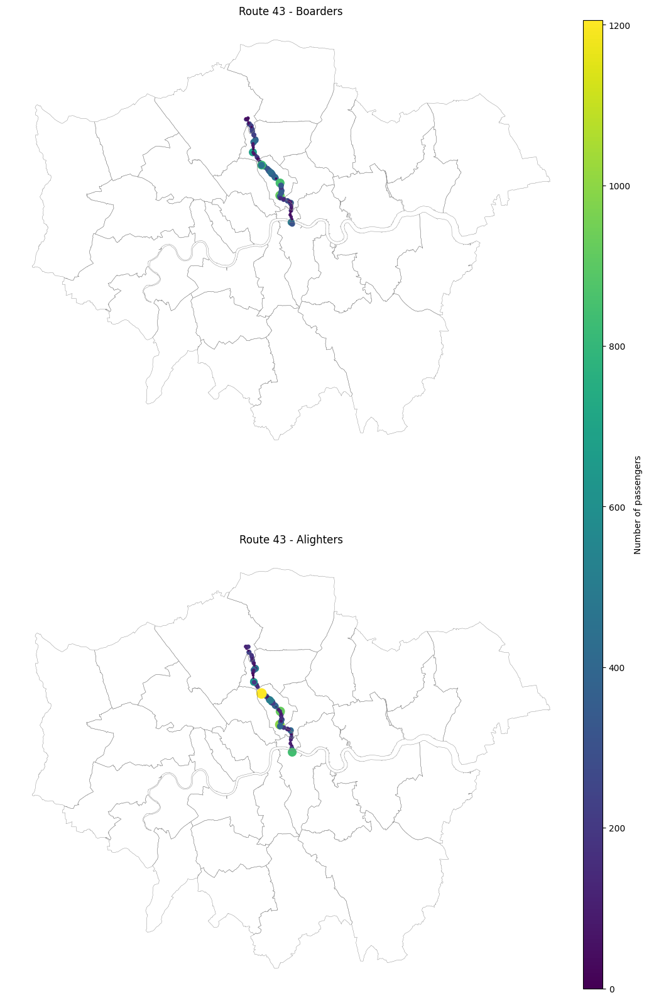

In [7]:
plot_route('sat',43)

In [66]:
# data set for sat
bus_flow_sat = bus_entex_by_day('sat')
bus_flow_sat = bus_flow_sat[['stop_id', 'stop_name', 'route_id','n_boarders' ,'n_alighters','geometry']]
bus_flow_sat.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 56212 entries, 0 to 56211
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   stop_id      56212 non-null  object  
 1   stop_name    56212 non-null  object  
 2   route_id     56212 non-null  object  
 3   n_boarders   56212 non-null  float64 
 4   n_alighters  56212 non-null  float64 
 5   geometry     56212 non-null  geometry
dtypes: float64(2), geometry(1), object(3)
memory usage: 2.6+ MB


In [67]:
# download the Greater London boundary
greater_london = ox.geocode_to_gdf('Greater London, UK')
greater_london = greater_london.to_crs(epsg=27700)

# subset points that are within the boundary of london
bus_flow_sat = bus_flow_sat[bus_flow_sat.geometry.intersects(greater_london.geometry[0])]

# filter n_alighters > 0
bus_flow_sat.rename(columns={'n_alighters':'total_exits', 'n_boarders':'total_entries'},inplace=True)
bus_flow_sat = bus_flow_sat[bus_flow_sat['total_exits'] > 0]
bus_flow_sat = bus_flow_sat[bus_flow_sat['total_entries'] > 0]
bus_flow_sat.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 39056 entries, 0 to 56211
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   stop_id        39056 non-null  object  
 1   stop_name      39056 non-null  object  
 2   route_id       39056 non-null  object  
 3   total_entries  39056 non-null  float64 
 4   total_exits    39056 non-null  float64 
 5   geometry       39056 non-null  geometry
dtypes: float64(2), geometry(1), object(3)
memory usage: 2.1+ MB


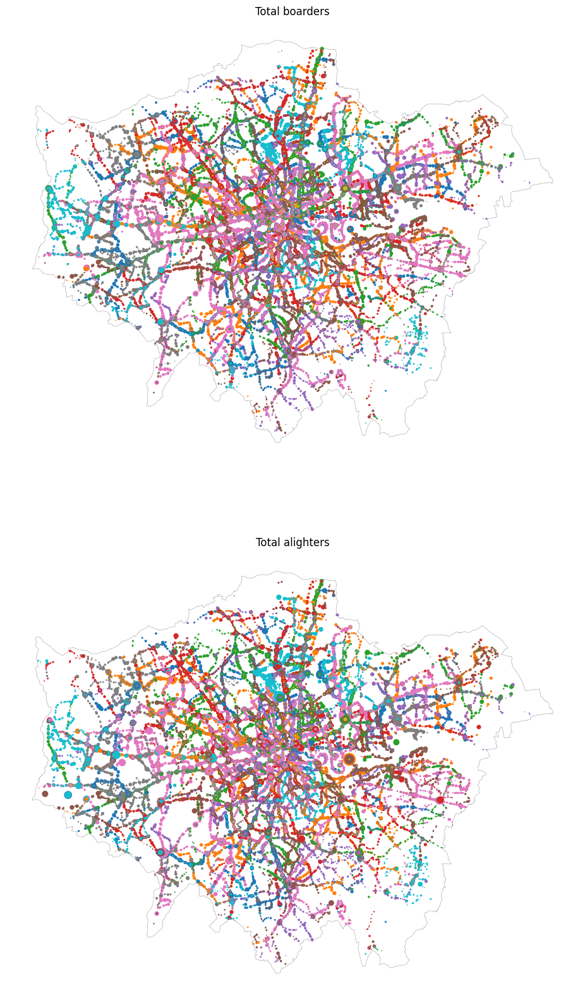

In [75]:
# plot based on Total alighters, marker size based on Total alighters / 20
fig,ax = plt.subplots(2,1,figsize=(15,20))
bus_flow_sat.plot(column='route_id',markersize=bus_flow_sat['total_entries']/20,ax=ax[0],legend=False)
bus_flow_sat.plot(column='route_id',markersize=bus_flow_sat['total_exits']/20,ax=ax[1],legend=False)
greater_london.boundary.plot(ax=ax[0], color='grey', linewidth=0.3)
greater_london.boundary.plot(ax=ax[1], color='grey', linewidth=0.3)
ax[0].set_title('Total boarders')
ax[1].set_title('Total alighters')
ax[0].set_axis_off()
ax[1].set_axis_off()
plt.show()

In [69]:
# export to geojson
bus_flow_sat.to_file('data/cleaned/flow_bus_byStopRoutes.gpkg', driver='GPKG')

In [70]:
# sum flow_bus by stop_id, n_aligters, n_boarders
flow_bus_byStop = bus_flow_sat.groupby('stop_id').agg({'stop_name':'first','total_entries':'sum','total_exits':'sum','geometry':'first'}).reset_index()
flow_bus_byStop = gpd.GeoDataFrame(flow_bus_byStop, geometry='geometry', crs='EPSG:27700')
flow_bus_byStop.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 16327 entries, 0 to 16326
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   stop_id        16327 non-null  object  
 1   stop_name      16327 non-null  object  
 2   total_entries  16327 non-null  float64 
 3   total_exits    16327 non-null  float64 
 4   geometry       16327 non-null  geometry
dtypes: float64(2), geometry(1), object(2)
memory usage: 637.9+ KB


In [77]:
# diff
flow_bus_byStop['diff'] = flow_bus_byStop['total_entries'] - flow_bus_byStop['total_exits']

In [78]:
# export to geojson
flow_bus_byStop.to_file('data/cleaned/flow_bus_byStop.gpkg', driver='GPKG')

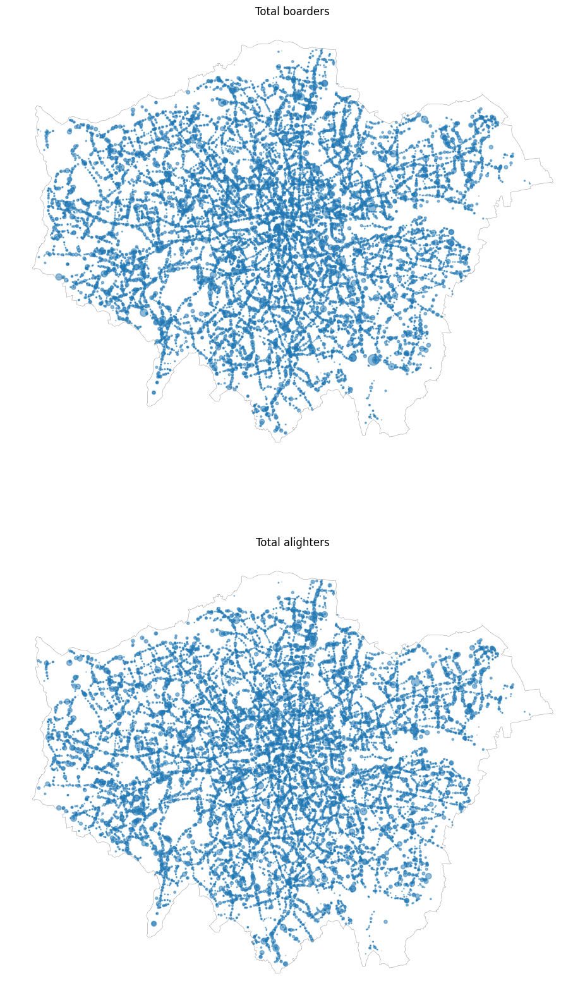

In [74]:
# plot based on Total alighters, marker size based on Total alighters / 20
fig,ax = plt.subplots(2,1,figsize=(15,20))
flow_bus_byStop.plot(markersize=bus_flow_sat['total_entries']/20,ax=ax[0],legend=False,alpha=0.5)
flow_bus_byStop.plot(markersize=bus_flow_sat['total_exits']/20,ax=ax[1],legend=False,alpha=0.5)
greater_london.boundary.plot(ax=ax[0], color='grey', linewidth=0.3)
greater_london.boundary.plot(ax=ax[1], color='grey', linewidth=0.3)
ax[0].set_title('Total boarders')
ax[1].set_title('Total alighters')
ax[0].set_axis_off()
ax[1].set_axis_off()
plt.show()

In [80]:
# folium map
import folium
from folium.plugins import MarkerCluster

# create a folium map
m = folium.Map(location=[51.5074, -0.1278], zoom_start=11, tiles='cartodbpositron')

test_df = flow_bus_byStop.to_crs(epsg=4326)

# add test_df
for i in range(0,len(test_df)):
    folium.CircleMarker(location=[test_df.iloc[i]['geometry'].y, test_df.iloc[i]['geometry'].x],
                        # lable with stop_name and stop_id
                        popup=folium.Popup(test_df.iloc[i]['stop_name'] + ' ' + test_df.iloc[i]['stop_id'], parse_html=True),
                        
                        # marker size based on Alighters
                        radius=test_df.iloc[i]['total_exits']/200,
                        color=None,
                        fill=True,
                        
                        # color scale based on diff, red if more boarders, blue if more alighters
                        fill_color='red' if test_df.iloc[i]['diff'] > 0 else 'blue',
                        alpha=0.5).add_to(m)

m